In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt



In [129]:
figure_folder = r'I:\MERFISH_Analysis\Merged_MOP\Figures_0626'
print(figure_folder)
if not os.path.exists(figure_folder):
    os.makedirs(figure_folder)
    
    
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white', transparent=True)
sc.settings.figdir = figure_folder

I:\MERFISH_Analysis\Merged_MOP\Figures_0626


## define location to save figures

In [130]:
data_folders= [r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220304-storm6_M1', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220329-storm6_M1', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220415-storm65', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220418-storm6',
              ]

adata_list = []
for _data_folder in data_folders:
    
    cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
    cell_meta_data = pd.read_csv(cell_meta_data_file)
    counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
    df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
    for _c in df.columns:
        if 'Blank-' in _c:
            df = df.drop(columns=_c)
    adata = anndata.AnnData(df)
    adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
    adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
    
    #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
    #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
    #_data = sc.read(_save_filename)
    adata_list.append(adata)
    

C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get t

In [131]:
merged_adata = anndata.concat(adata_list, )

# 3. Preprocess and filter the MERFISH data 

In [132]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

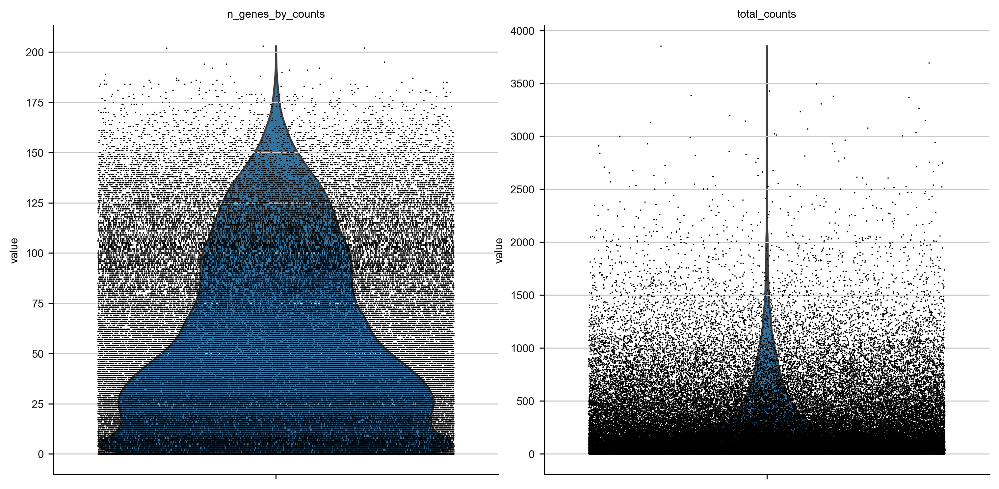

In [133]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

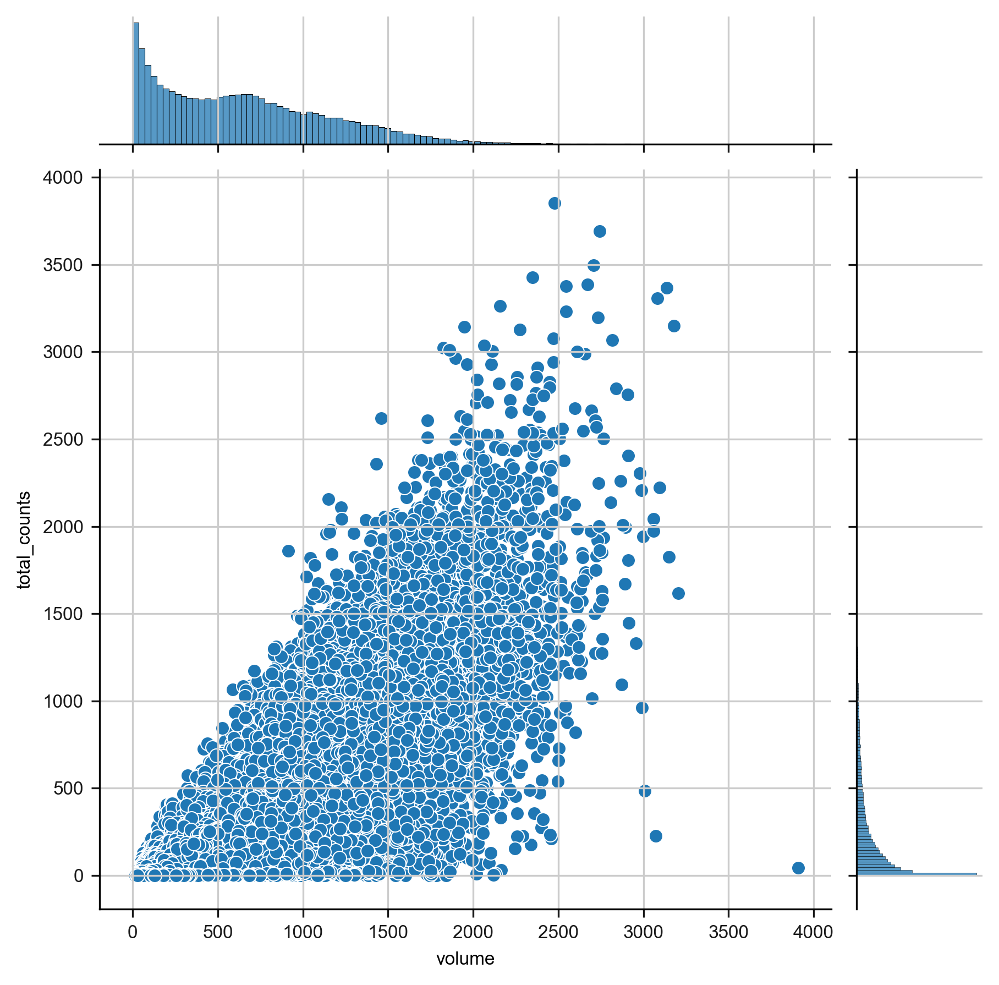

In [134]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts')

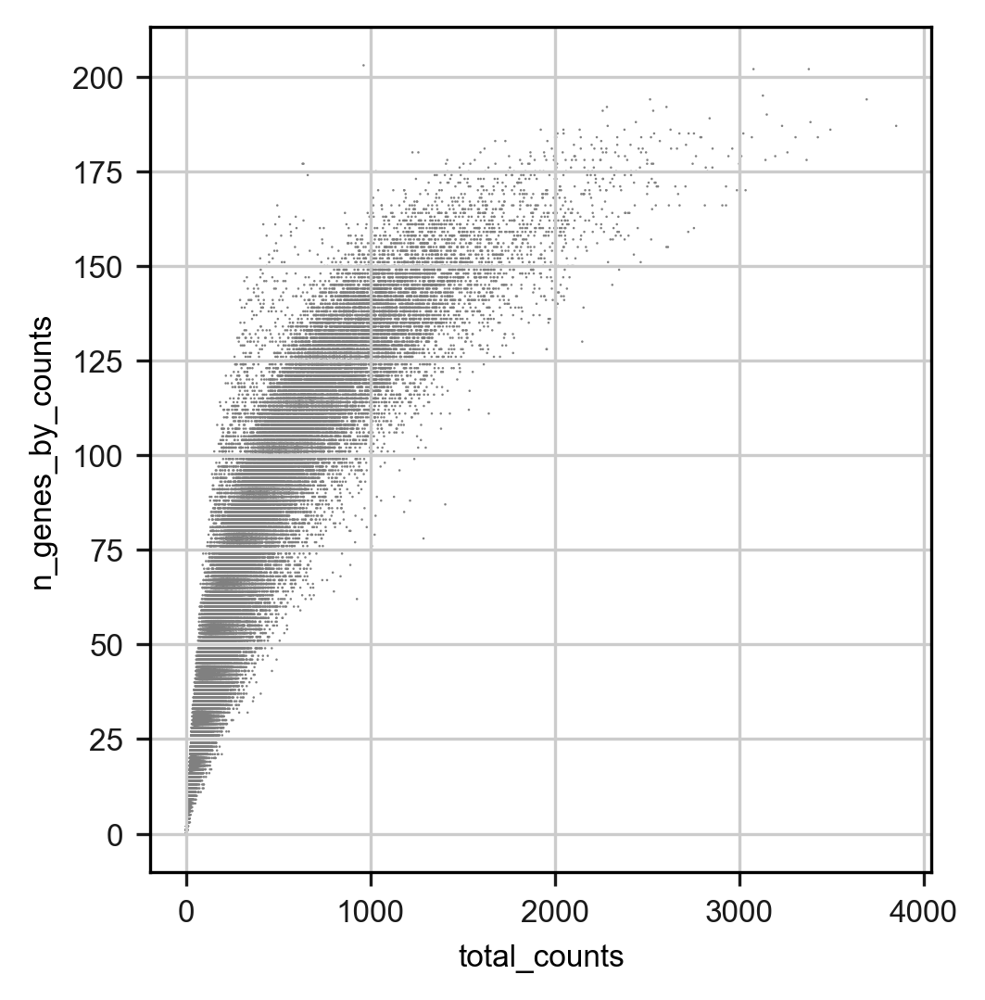

In [135]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [136]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

63431


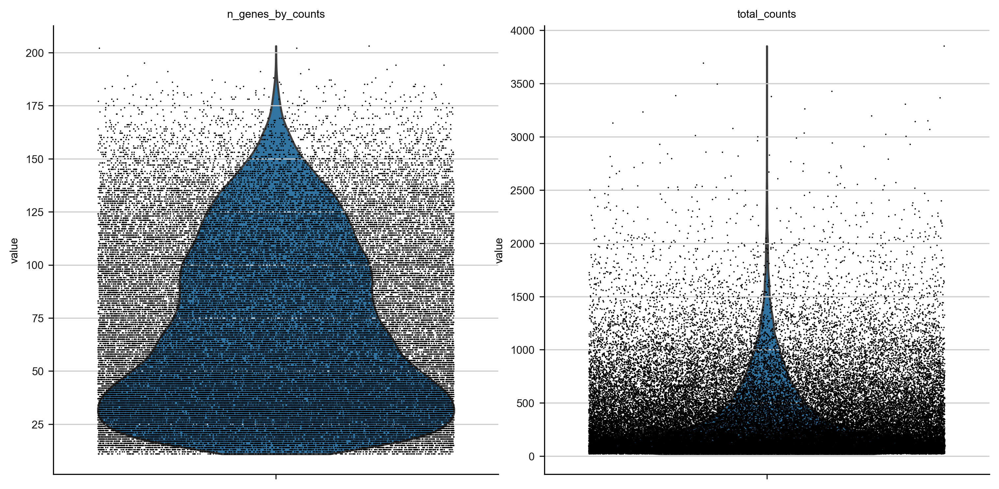

In [137]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [138]:
np.mean(merged_adata.obs['total_counts'])

355.3042297363281

## filter doublet

In [139]:
sc.external.pp.scrublet(merged_adata)

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:182: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.81
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\external\pp\_scrublet.py:227: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = adata_obs.obs['doublet_score']


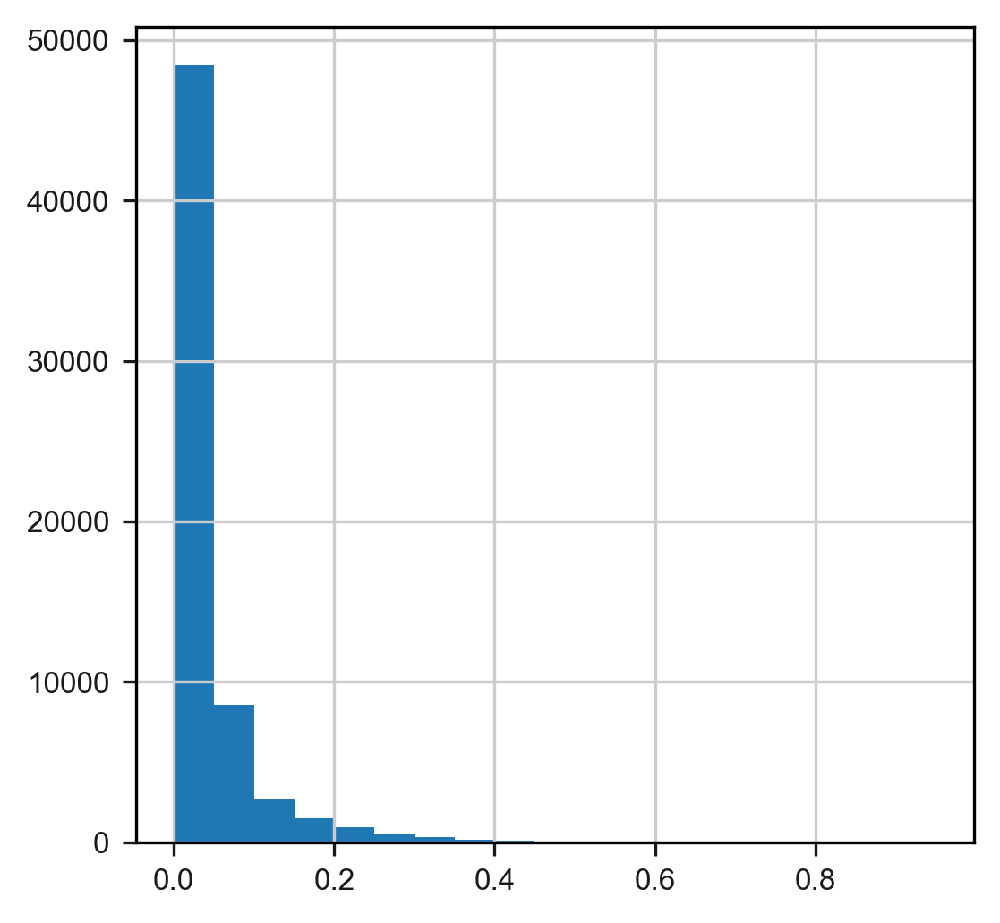

0.0113824470684681

In [140]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()
np.mean(merged_adata.obs['doublet_score'] > 0.3)

In [141]:
# remove potential doublet
doublet_score_th = 0.3
merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

62709

# 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


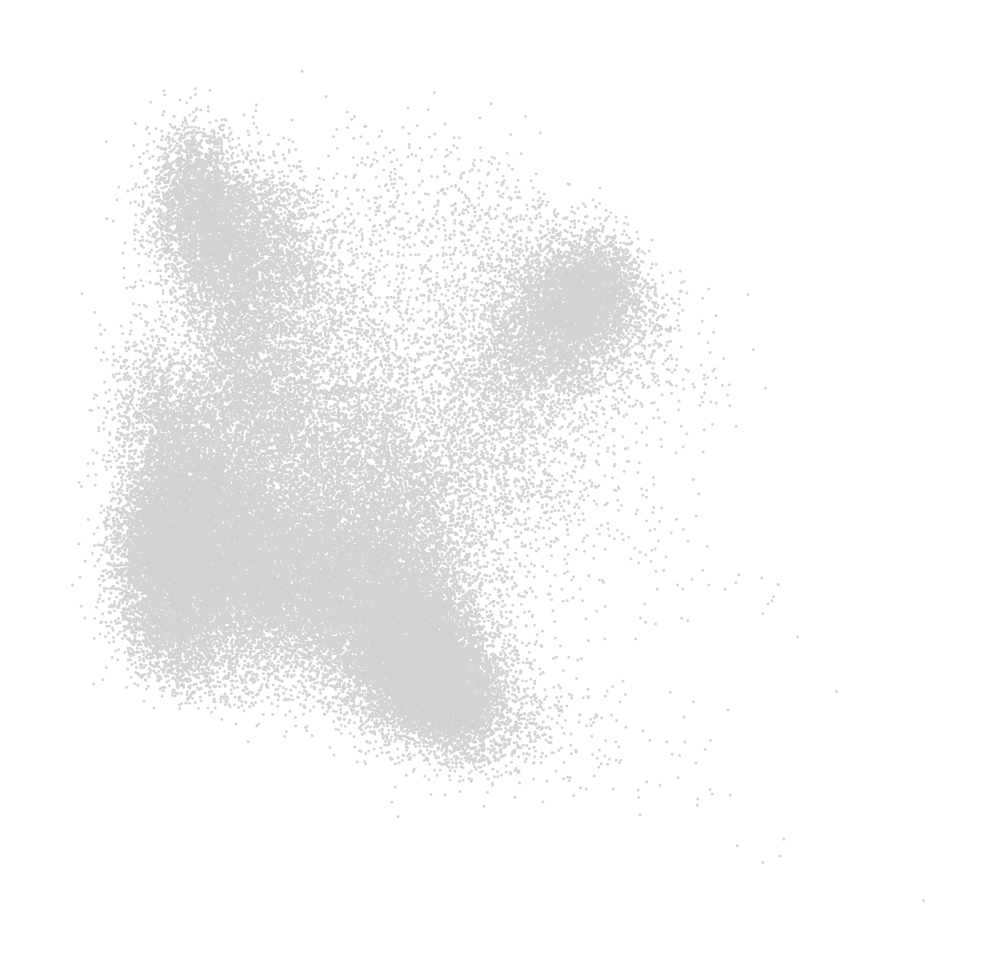

Wall time: 1min 11s


In [142]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata)

In [221]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=20, n_pcs=20)
# Clustering
sc.tl.leiden(merged_adata, resolution=1)

Wall time: 1min 21s


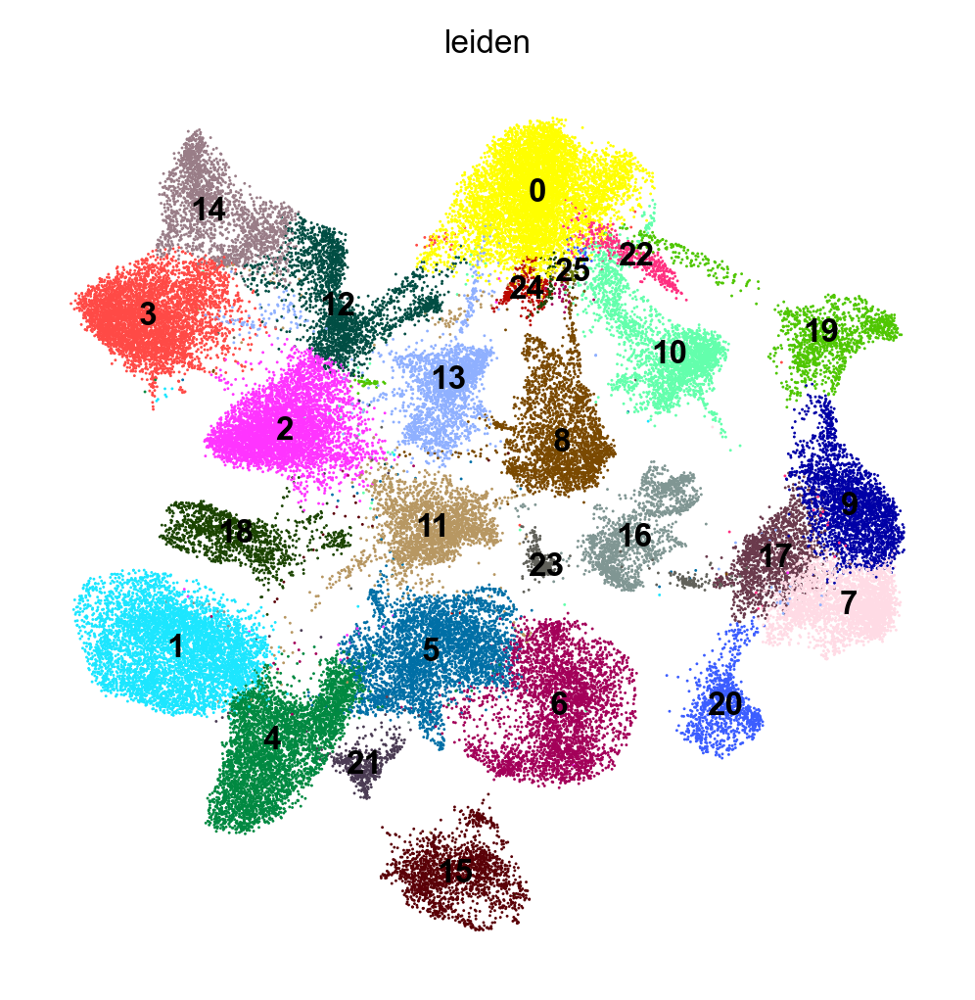

Wall time: 3min 15s


In [148]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

In [222]:
merged_adata.obs['leiden_subclass'] = merged_adata.obs.leiden

## 4.2 check reproduciblilty

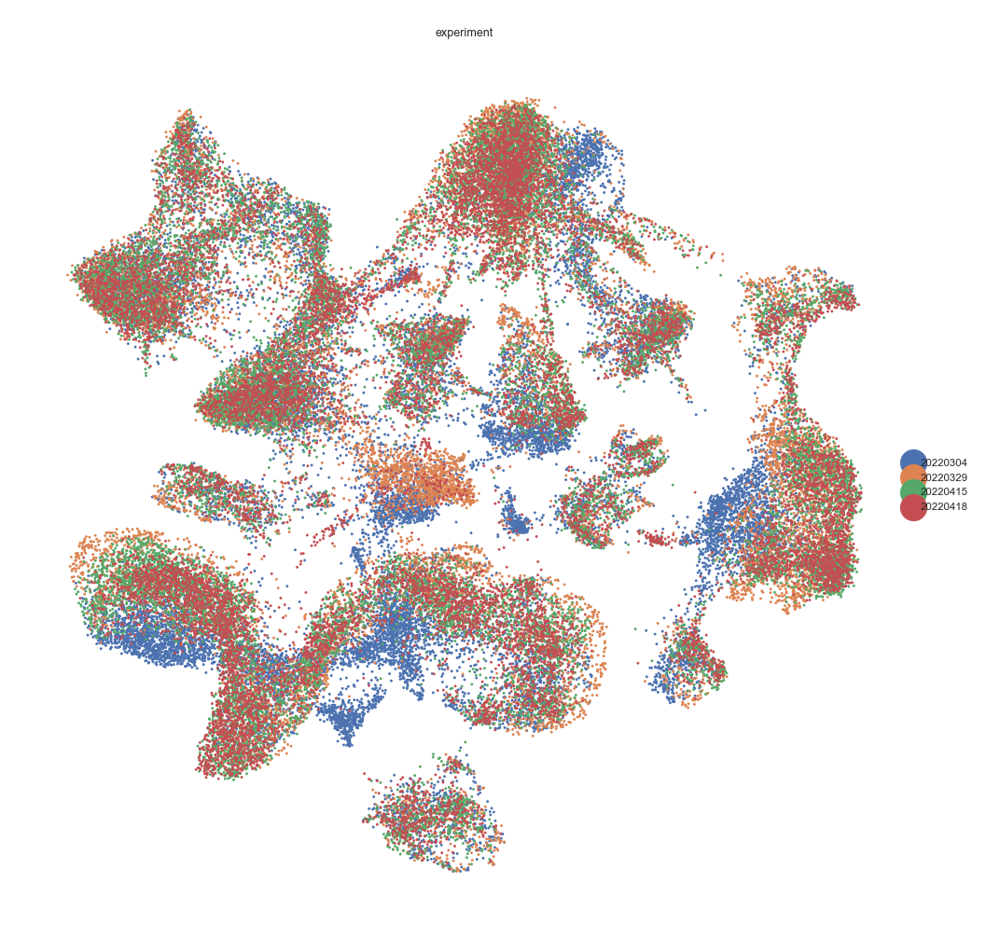

In [223]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color='experiment', )

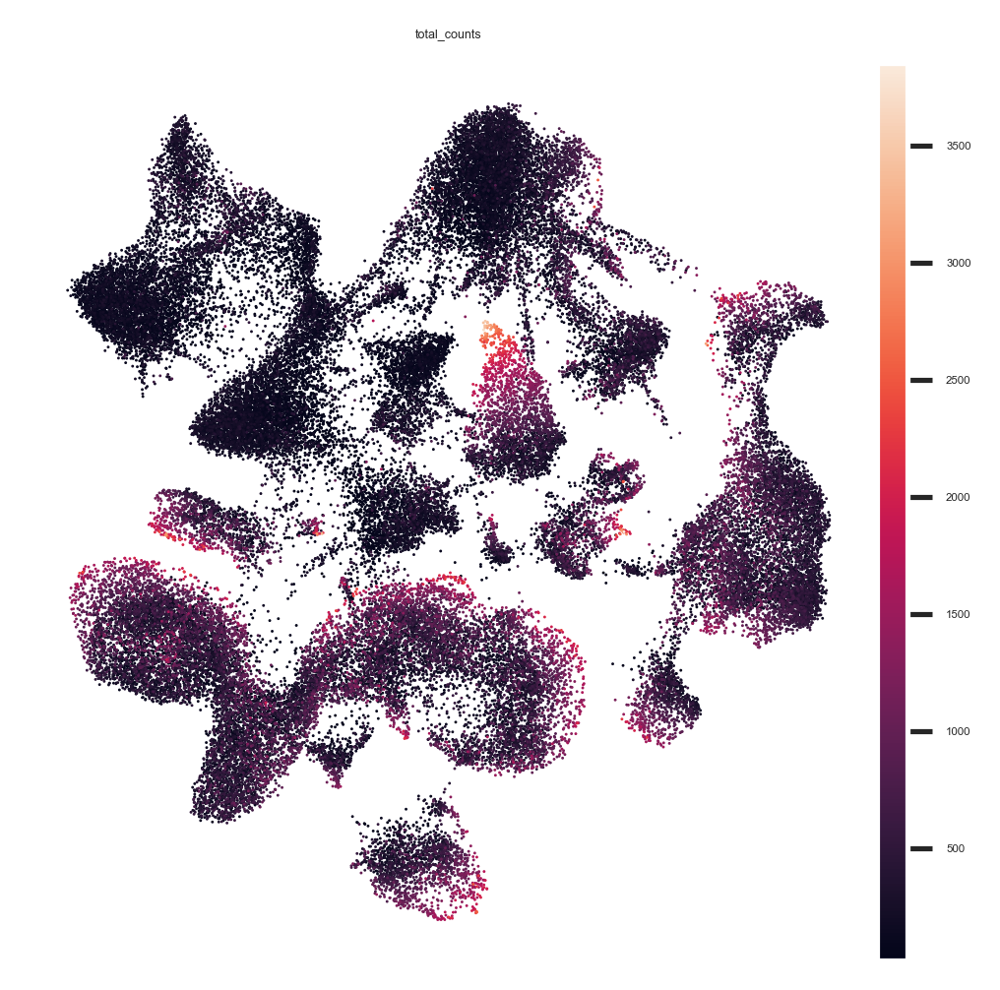

In [224]:
sc.pl.umap(merged_adata, color='total_counts')

# 5. Check count for each cell for genes of interest

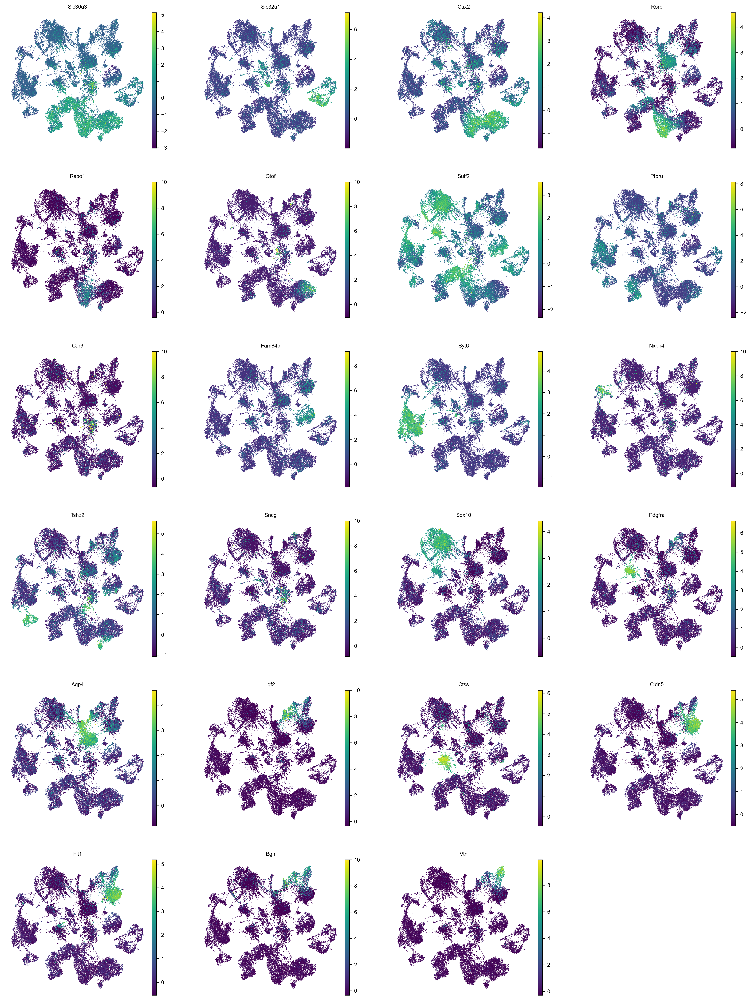

In [31]:
# Visualize marker genes
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in merged_adata.var.index)]

sc.pl.umap(merged_adata, color=marker_genes)

# 6 Test different parameters for UMAP

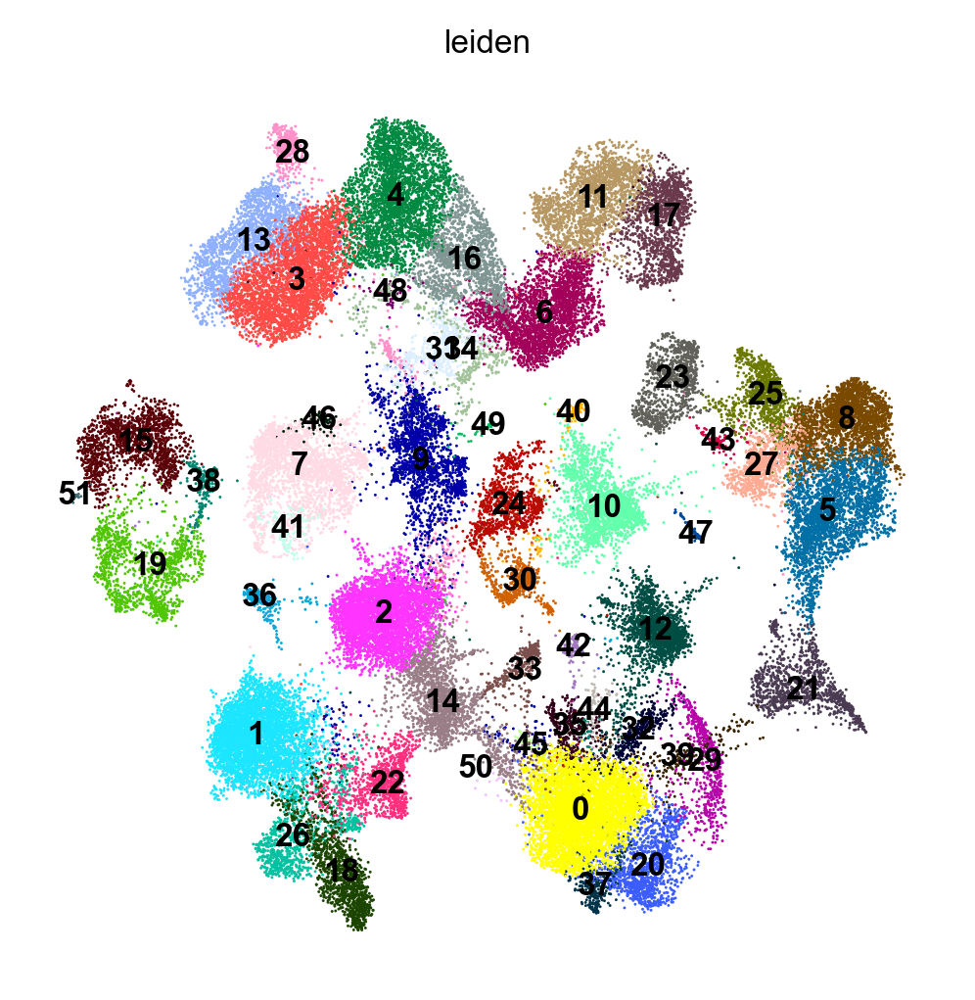

Wall time: 2min 2s


In [33]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=8, n_pcs=50)

sc.tl.leiden(merged_adata, resolution=2.)

sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
merged_adata.obs['leiden_cluster'] = merged_adata.obs.leiden

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [34]:
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\Merged_MOP\filtered_cluster_data.h5ad


# 8. Cell type classifier

In [35]:
# read from file
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')
merged_adata = sc.read(save_filename)

## 8.1 load Meng's dataset

In [36]:
meng_merfish_raw = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\counts.h5ad'
merfish_raw = sc.read_h5ad(meng_merfish_raw)
meng_merfish_label = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\cell_labels.csv'
merfish_label = pd.read_csv(meng_merfish_label, index_col=0)

In [37]:
merData = pd.DataFrame(merfish_raw.X, index = merfish_raw.obs.index, columns = merfish_raw.var.index)
labels = merfish_label.loc[merfish_label['label']!='-1']
# merge dataframes
merCluster=merData.merge(labels, how='inner', left_index=True, right_index=True)

In [38]:
from sklearn import preprocessing
# Scale variable measurements for model training
merGroupedDataZ = pd.DataFrame(preprocessing.scale(merCluster.iloc[:,:-5]),index = merCluster.iloc[:,:-5].index, columns = merCluster.iloc[:,:-5].columns)

merGroupedDataZ['subclass'] = merCluster.iloc[:,-2]

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


## 8.2 train classfier with Meng's dataset

In [39]:
adata_ref = merGroupedDataZ

# Train the classifer using the shared varibales
genes_from_ref = set(merData.columns)
genes = list(genes_from_ref.intersection(set(merged_adata.var.index)))

In [40]:
%%time
from sklearn.neural_network import MLPClassifier

# Train a classifier
gene_ids = [merData.columns.get_loc(g) for g in genes]

print('Train cell type classifier.')

X = np.array(adata_ref.iloc[:,:-1])[:, gene_ids]
Y = np.array(adata_ref['subclass'])
nnc = MLPClassifier(max_iter = 500)
nnc.fit(X, Y)

Train cell type classifier.
Wall time: 5h 20min 5s


MLPClassifier(max_iter=500)

In [41]:
import pickle
pickle.dump(nnc, open(os.path.join(save_folder, 'trained_MLP_classifier.pkl'), 'wb'), )

# 8.3 initial prediction

In [42]:
%run "..\..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
import ImageAnalysis3.celltype_tools.classifier as clsf

In [65]:
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white', transparent=True)
sc.settings.figdir = figure_folder

In [96]:
# load h5ad if necessary
load_h5ad = True
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')

if load_h5ad:
    merged_adata = sc.read_h5ad(save_filename)

In [225]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/1208267940.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


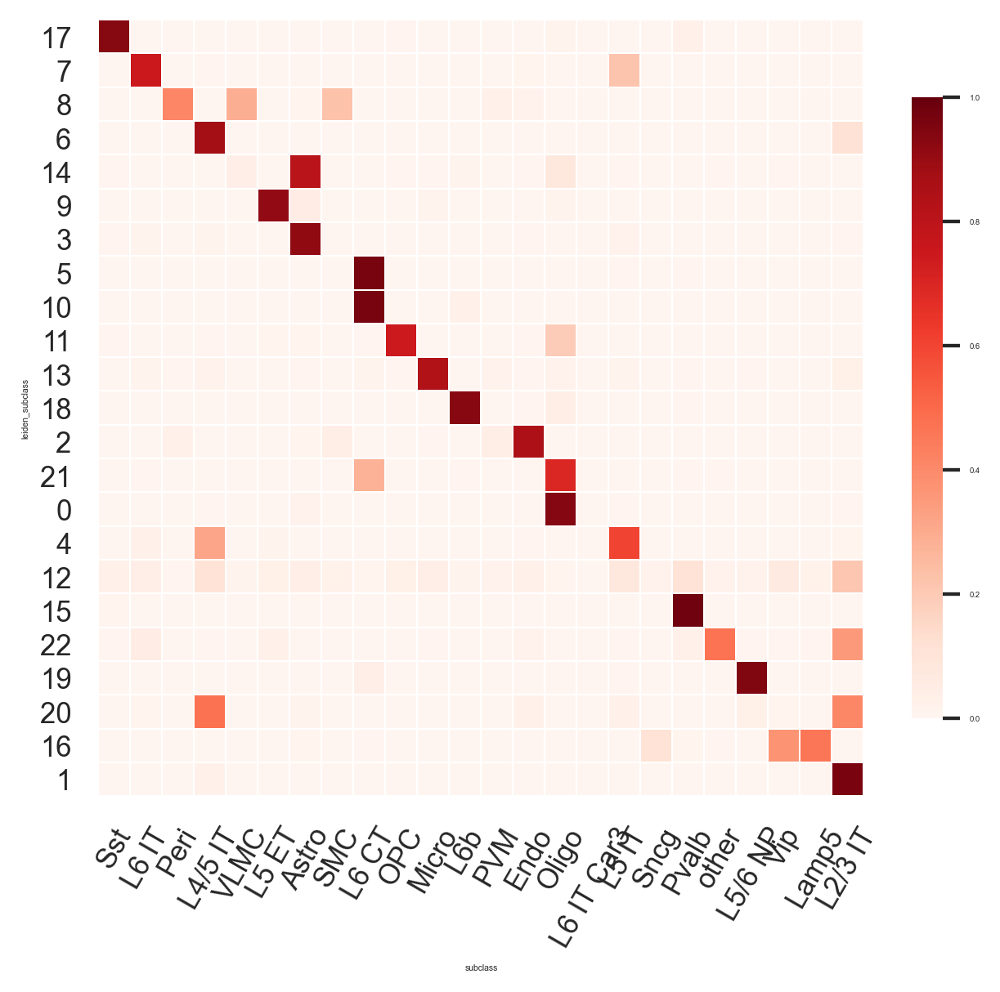

In [227]:
# Plot
fig1=plt.figure(figsize=(6,5),dpi=125)
#sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

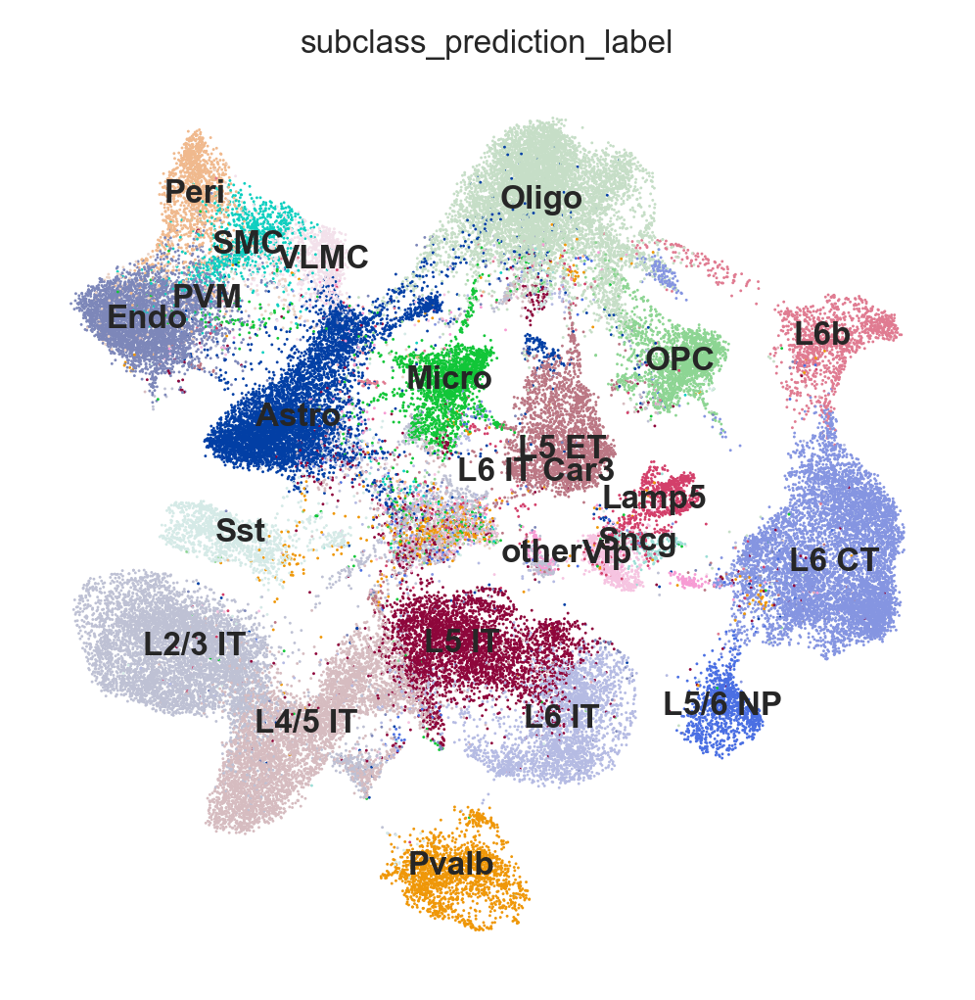

In [229]:
# Plot the predicted labels on UMAP to guide the manual labeling of the de novo clustering below
# use this to manually merge and split the original query column (e.g., leiden_subclass)
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

sc.pl.umap(merged_adata, color='subclass_prediction_label', legend_loc='on data')

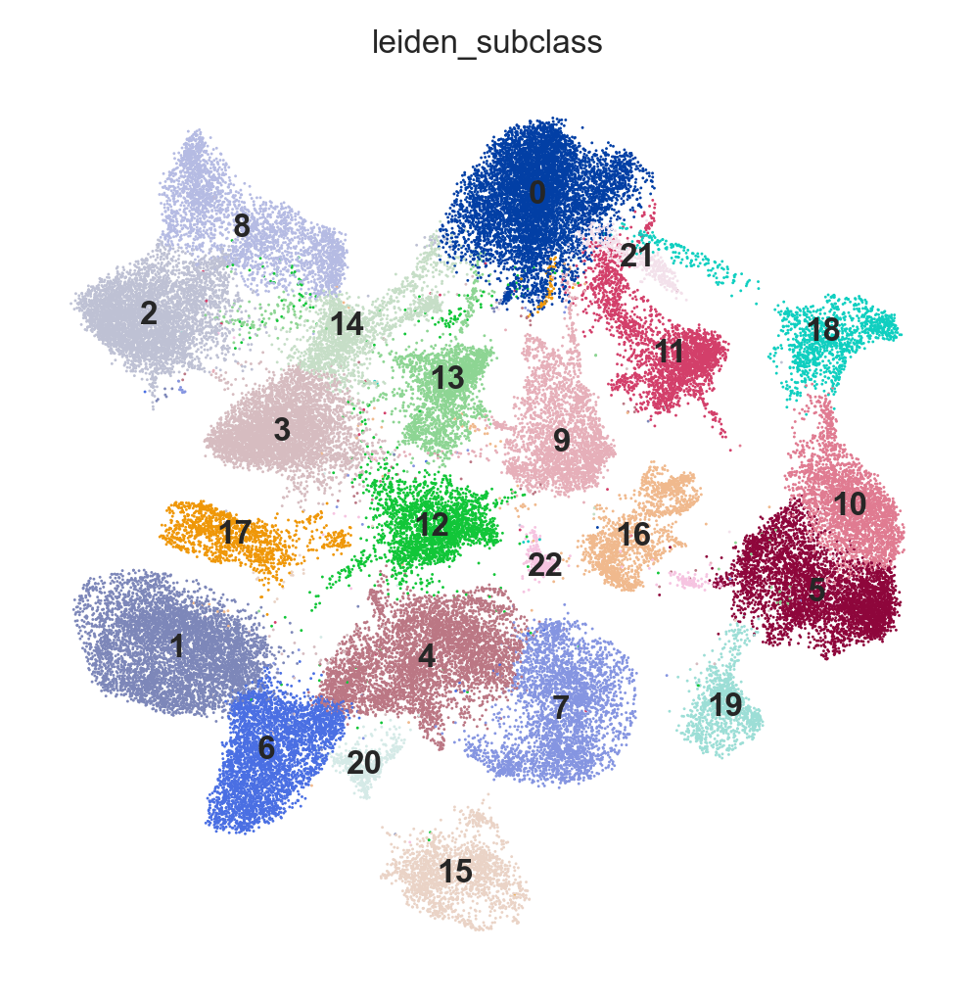

In [230]:
# Plot clustering as ref
sc.pl.umap(merged_adata, color=query_cluster_column, legend_loc='on data')

## 8.4 Split labels

by comparing two UMAP above, we could estimate which cluster should be further splitted

In [241]:
print(query_cluster_column)
merged_adata.obs['leiden_subclass_sub'] = merged_adata.obs[query_cluster_column].copy()
# manual split
sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['8']), key_added='leiden_subclass_sub')

sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['11']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['16']), key_added='leiden_subclass_sub')

sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['21']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['22']), key_added='leiden_subclass_sub')



leiden_subclass


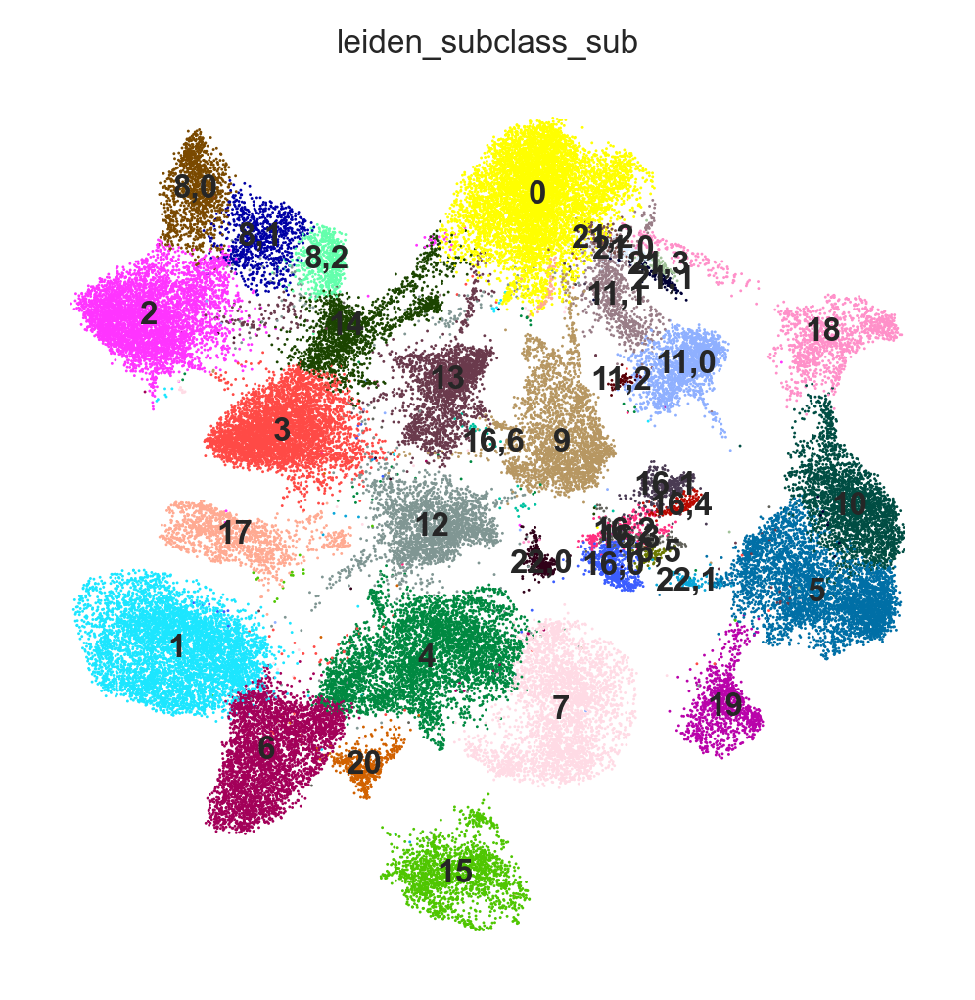

In [242]:
sc.pl.umap(merged_adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

In [278]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
fine_query_cluster_column = 'leiden_subclass_sub'
#fine_query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[fine_query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[fine_query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/673941203.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


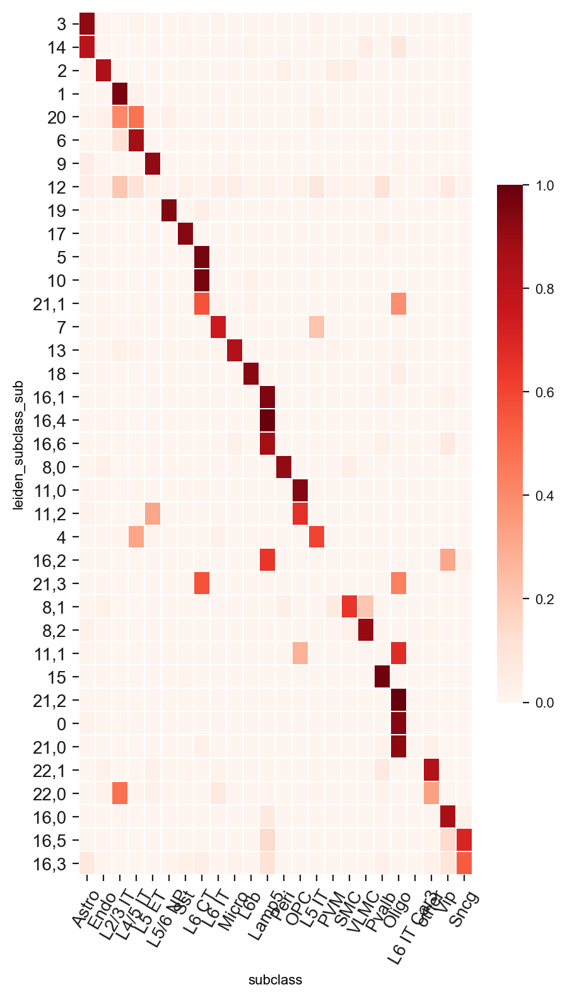

In [279]:
# Plot
fig1=plt.figure(figsize = (5,9), dpi=100)
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(fine_query_cluster_column)
plt.show()

## 8.6 Assign most of uniquely classfied clusters

In [280]:
first_assign_dict = {}
missed_classes = []
# Automatic assign best fit if applicable
assign_th = 0.6
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]
    else:
        missed_classes.append(_cluster)

0 Oligo
1 L2/3 IT
2 Endo
3 Astro
4 L5 IT
5 L6 CT
6 L4/5 IT
7 L6 IT
8,0 Peri
8,1 SMC
8,2 VLMC
9 L5 ET
10 L6 CT
11,0 OPC
11,1 Oligo
11,2 OPC
13 Micro
14 Astro
15 Pvalb
16,0 Vip
16,1 Lamp5
16,2 Lamp5
16,4 Lamp5
16,5 Sncg
16,6 Lamp5
17 Sst
18 L6b
19 L5/6 NP
21,0 Oligo
21,2 Oligo
22,1 other


In [281]:
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

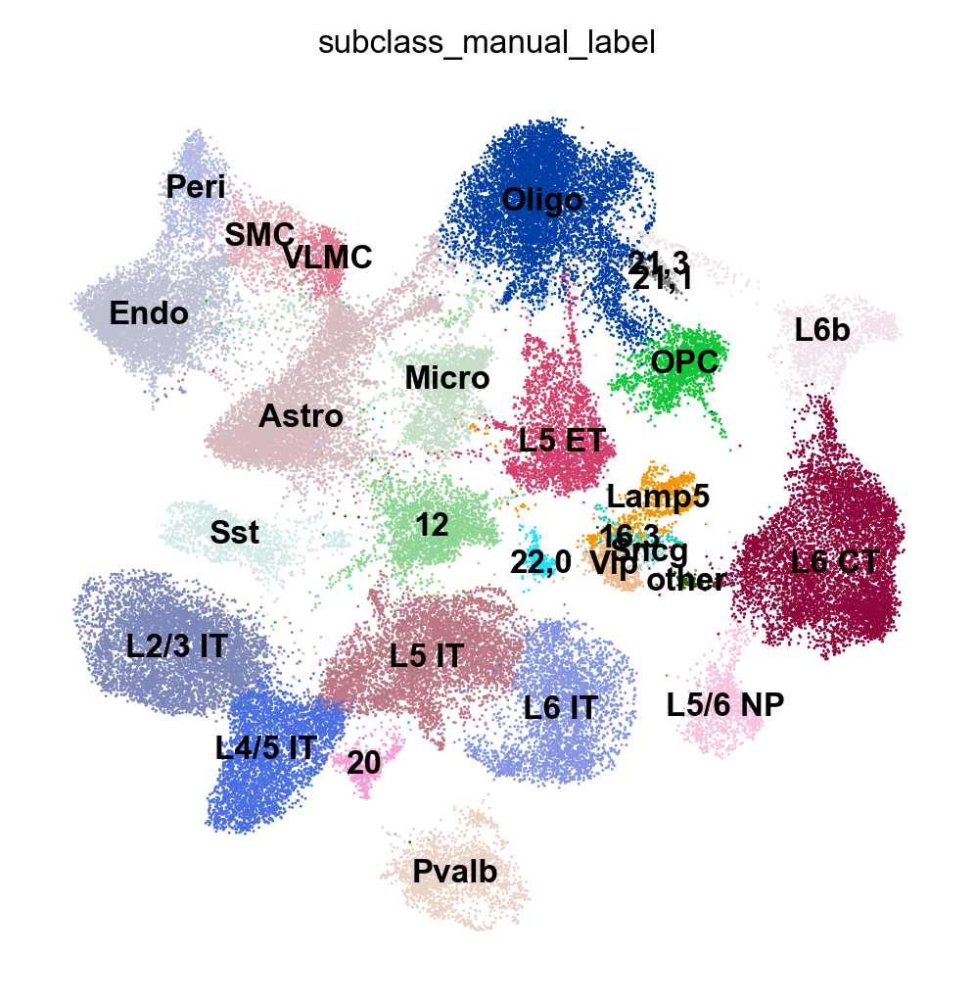

In [290]:
merged_adata.obs['subclass_manual_label'] = merged_adata.obs['leiden_subclass_sub'].copy()
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(merged_adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data',)

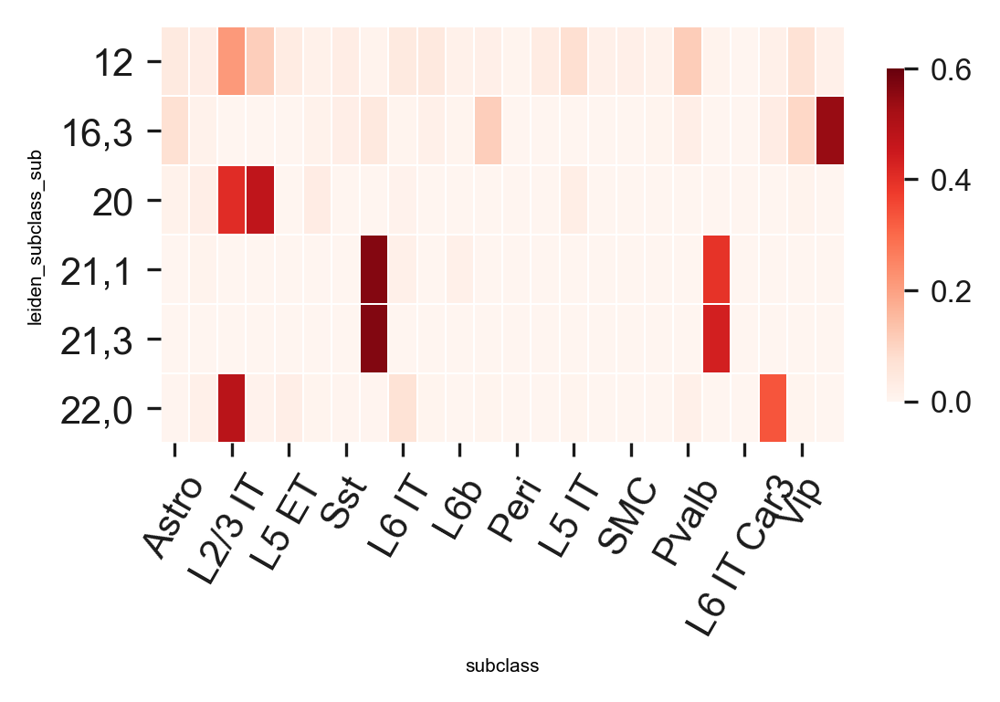

In [291]:
# Plot
fig1=plt.figure(figsize = (4,2), dpi=150)
#sns.set(font_scale=0.25)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted.loc[missed_classes], 
            cmap='Reds', vmin=0, vmax=assign_th, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column, fontsize=5) 
plt.ylabel(fine_query_cluster_column, fontsize=5)
plt.show()

## 8.7 Manual assign leftovers

In [292]:
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

In [293]:
print(missed_classes)

for _cls in missed_classes:
    print(_cls)
    print((fractions.loc[_cls].index.values)[np.argsort(fractions.loc[_cls].values)[::-1]][::5])
    print(np.sort(fractions.loc[_cls].values)[::-1][::5])

['12', '16,3', '20', '21,1', '21,3', '22,0']
12
['L2/3 IT' 'Micro' 'Endo' 'other' 'Oligo']
[0.21264368 0.04228243 0.02873563 0.01724138 0.0090312 ]
16,3
['Sncg' 'other' 'L5/6 NP' 'L2/3 IT' 'SMC']
[0.5398773  0.03067485 0.01226994 0.         0.        ]
20
['L4/5 IT' 'Astro' 'Micro' 'L6b' 'SMC']
[0.47294589 0.01202405 0.00200401 0.         0.        ]
21,1
['L6 CT' 'other' 'L5/6 NP' 'OPC' 'Sncg']
[0.56410256 0.         0.         0.         0.        ]
21,3
['L6 CT' 'L2/3 IT' 'L6 IT' 'OPC' 'Sncg']
[0.56626506 0.         0.         0.         0.        ]
22,0
['L2/3 IT' 'Pvalb' 'Vip' 'OPC' 'Peri']
[0.48421053 0.01754386 0.00701754 0.         0.        ]


In [294]:
manual_assign_dict = {
    '16,3':'Sncg',
    '20':'L4/5 IT',
    '21,1':'L6 CT',
    '21,3':'L6 CT',
    '22,0':'L2/3 IT',
}
manual_other_dict = {_c:'other' for _c in missed_classes if _c not in manual_assign_dict}

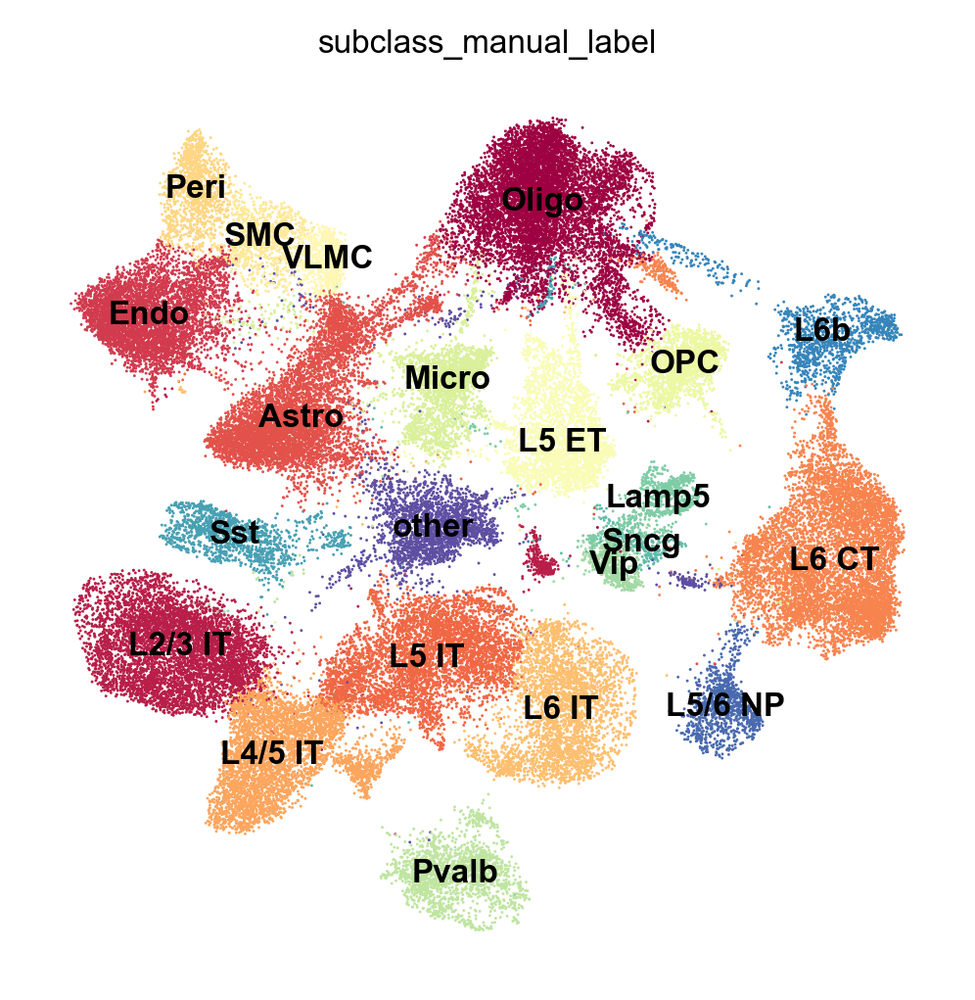

In [295]:
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':manual_assign_dict})
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':manual_other_dict})
np.unique(merged_adata.obs['subclass_manual_label'])

sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data', palette='Spectral')

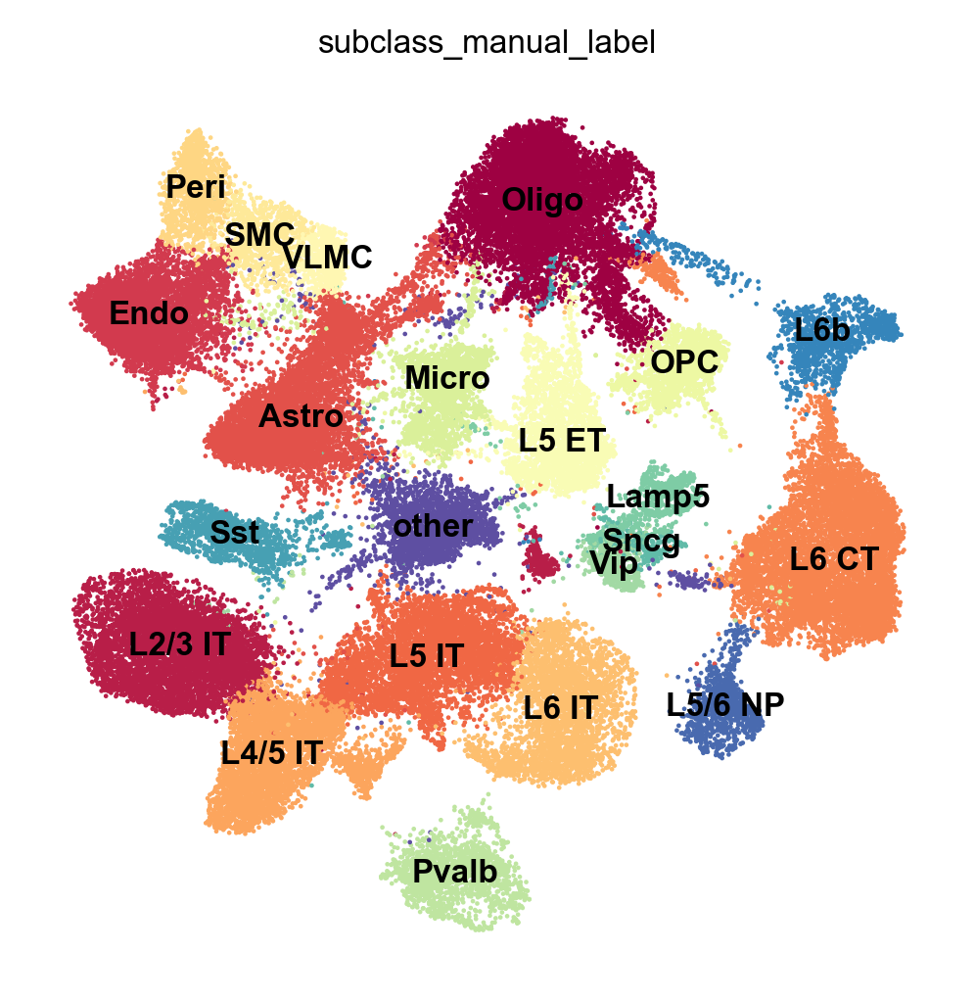

In [296]:
sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data', size=5,
           cmap='Spectral',
           save='_manual_subclass')
#plt.savefig(os.path.join())

In [297]:
types, counts = np.unique(merged_adata.obs['subclass_manual_label'], return_counts=True)

In [298]:
for _type, _count in zip(types, counts):
    print(_type, _count)

Astro 6462
Endo 4645
L2/3 IT 5605
L4/5 IT 4217
L5 ET 2612
L5 IT 4627
L5/6 NP 1032
L6 CT 7081
L6 IT 3191
L6b 1284
Lamp5 753
Micro 2207
OPC 1799
Oligo 7988
Peri 1184
Pvalb 1764
SMC 852
Sncg 255
Sst 1381
VLMC 663
Vip 564
other 2543


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/40977473.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(types, rotation=45)
C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/40977473.py:5: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


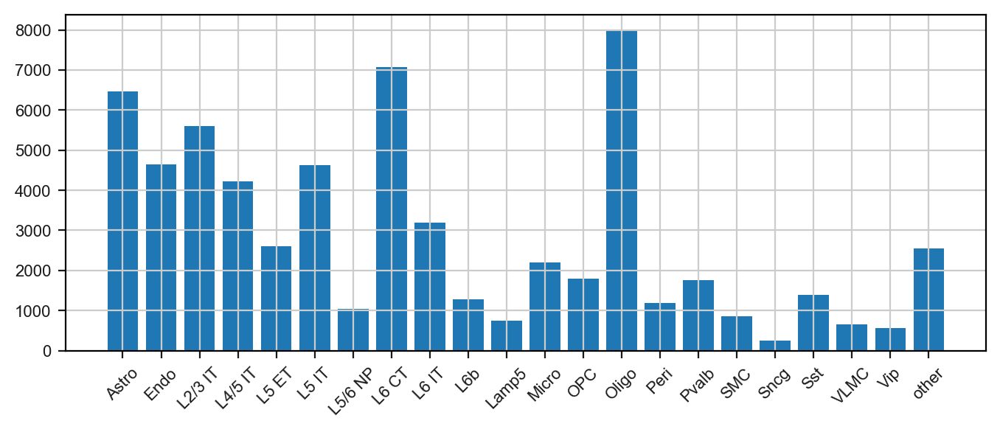

In [299]:
# print class number
fig, ax = plt.subplots(figsize=(8,3), dpi=100)
ax.bar(types, counts)
ax.set_xticklabels(types, rotation=45)
fig.show()

# 9. Redo prediction for manual labels

Check consistency between manual labels vs. predict labels

In [300]:
prediction_column = 'subclass_manual_label_predict'

ref_cluster_column = 'subclass'

# determine which class to query
check_query_cluster_column = 'subclass_manual_label'

print(f'Predict cell types: {check_query_cluster_column}')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[check_query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[check_query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

Predict cell types: subclass_manual_label


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/1802131006.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


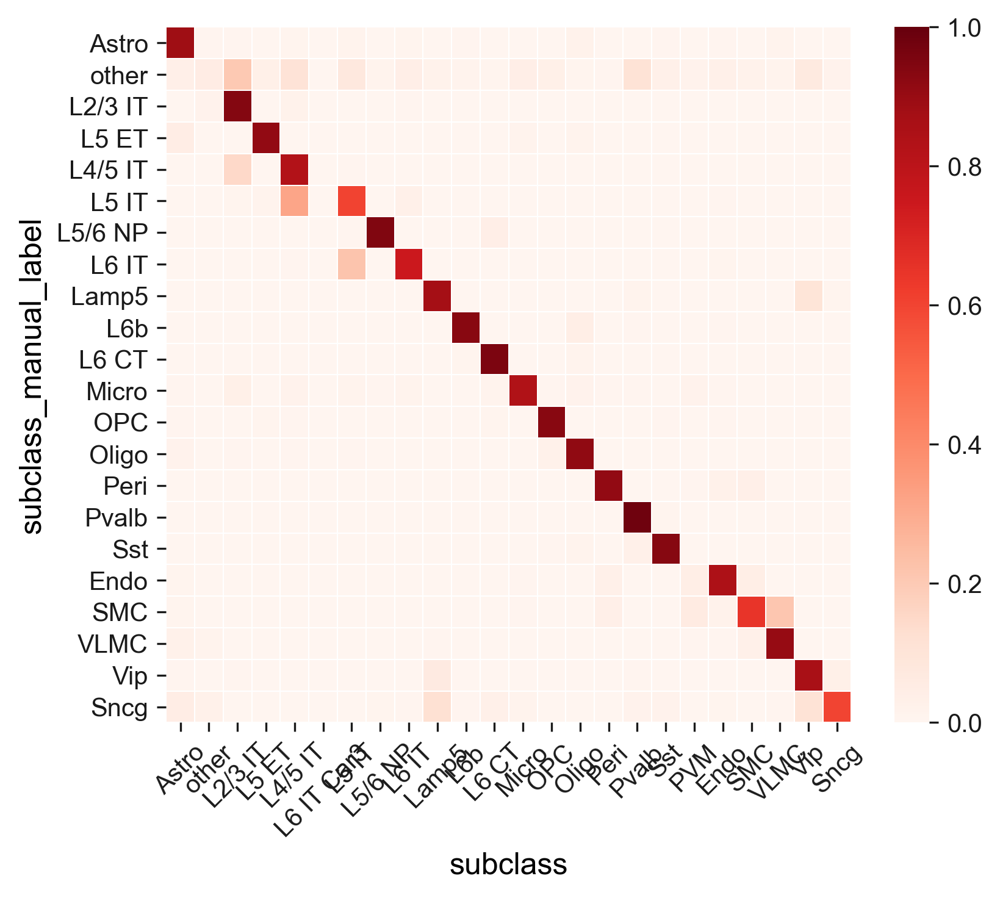

In [301]:
# Plot
fig1=plt.figure(figsize = (6,5))
#sns.set(font_scale=0.2)

ax = sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": 1})
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=10)

plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column, size=12) 
plt.ylabel(check_query_cluster_column, size=12)
plt.savefig(os.path.join(figure_folder, 'match_predictClass.pdf'), transparent=True)
plt.show()

20220418


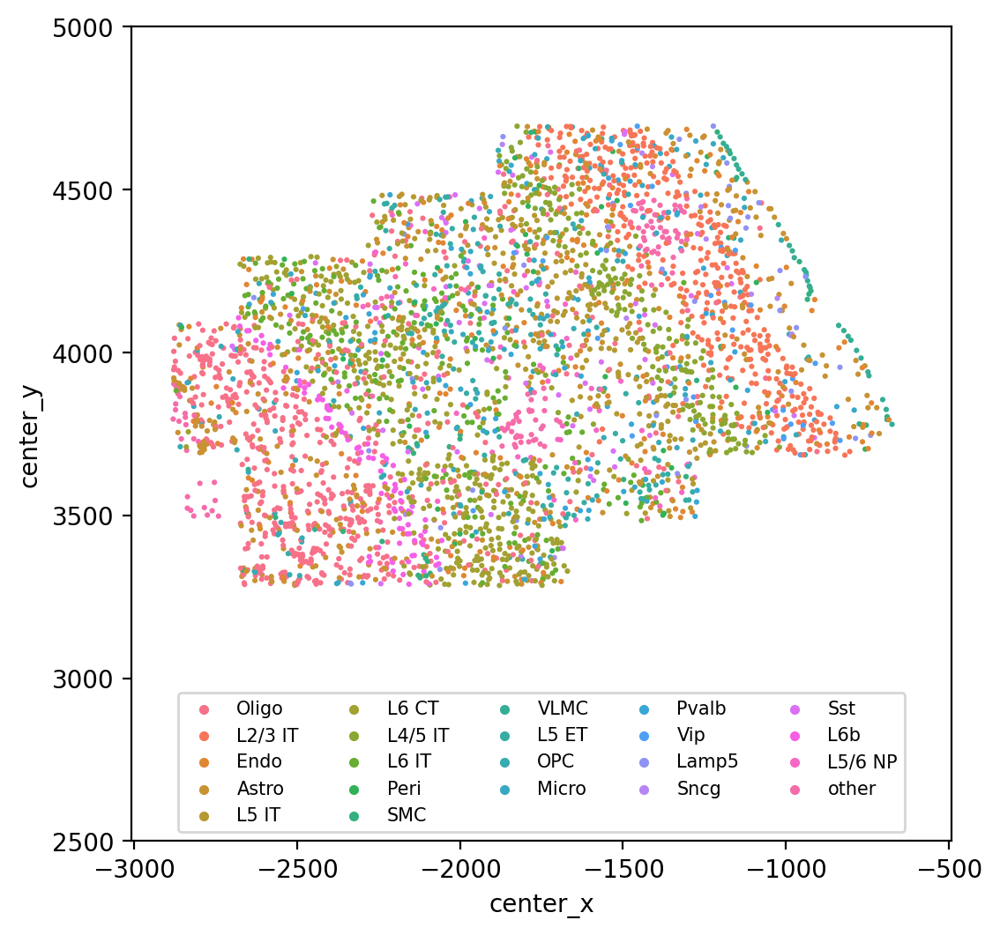

In [302]:
# scatter plot for distributions
plt.style.use('default')

experiments = np.unique(merged_adata.obs['experiment'])
sel_exp_id = 3
print(experiments[sel_exp_id])
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_exp_id]]

# visualzie the spatial dist for clusters
#plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(6,6), dpi=100)
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([-3000,-500])
plt.ylim([2500, 5000])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=5, loc=8, fontsize=7.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_all_exp-{experiments[sel_exp_id]}.pdf'), 
            dpi=300, transparent=True)
plt.show()

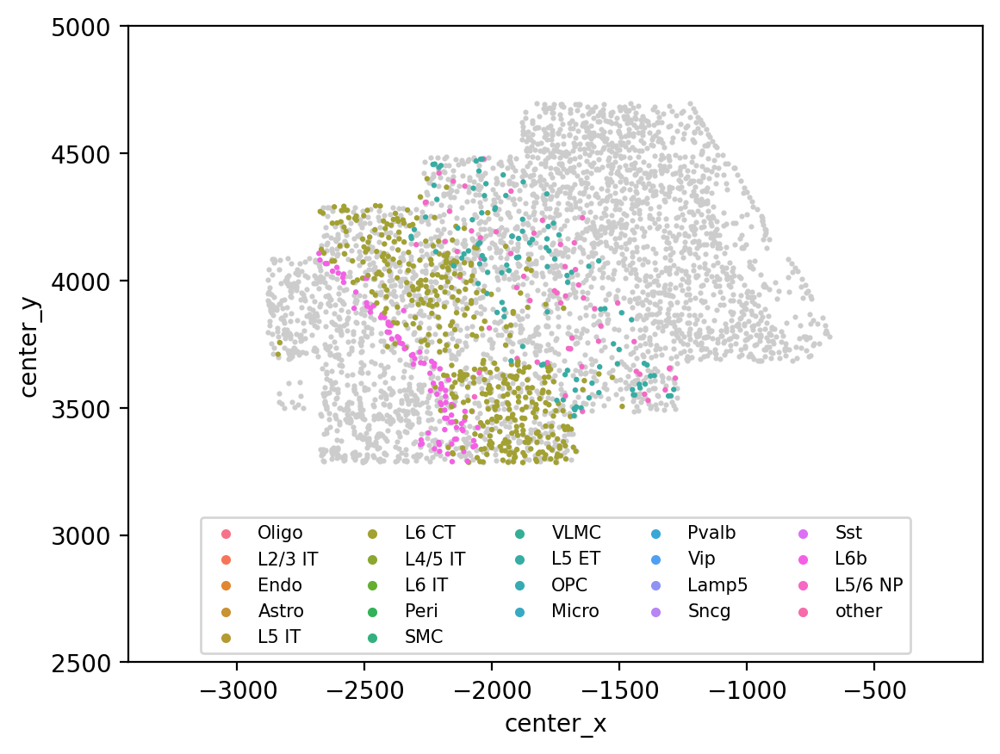

In [303]:
ExciteTypes = ['L5 ET', 'L5/6 NP', 'L6 CT', 'L6b']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ExciteTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([-3000,-500])
plt.ylim([2500, 5000])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=5, loc=8, fontsize=7.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_excite_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

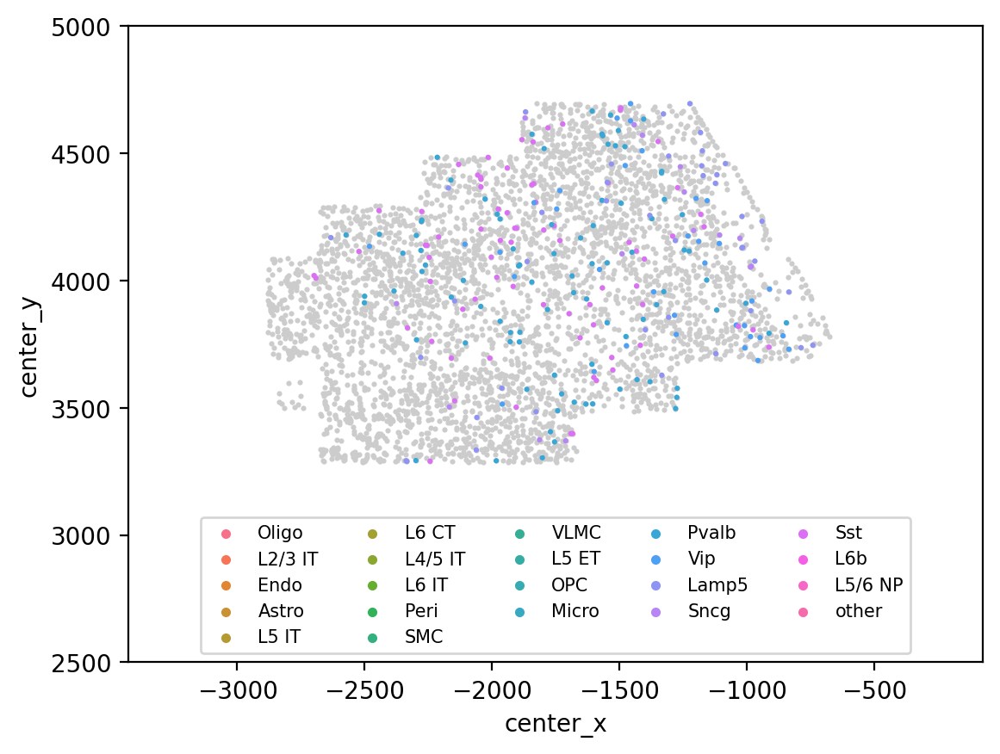

In [304]:
InhbitTypes = ['Lamp5', 'Pvalb', 'Sncg', 'Sst', 'Vip']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in InhbitTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([-3000,-500])
plt.ylim([2500, 5000])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=5, loc=8, fontsize=7.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_inhibit_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

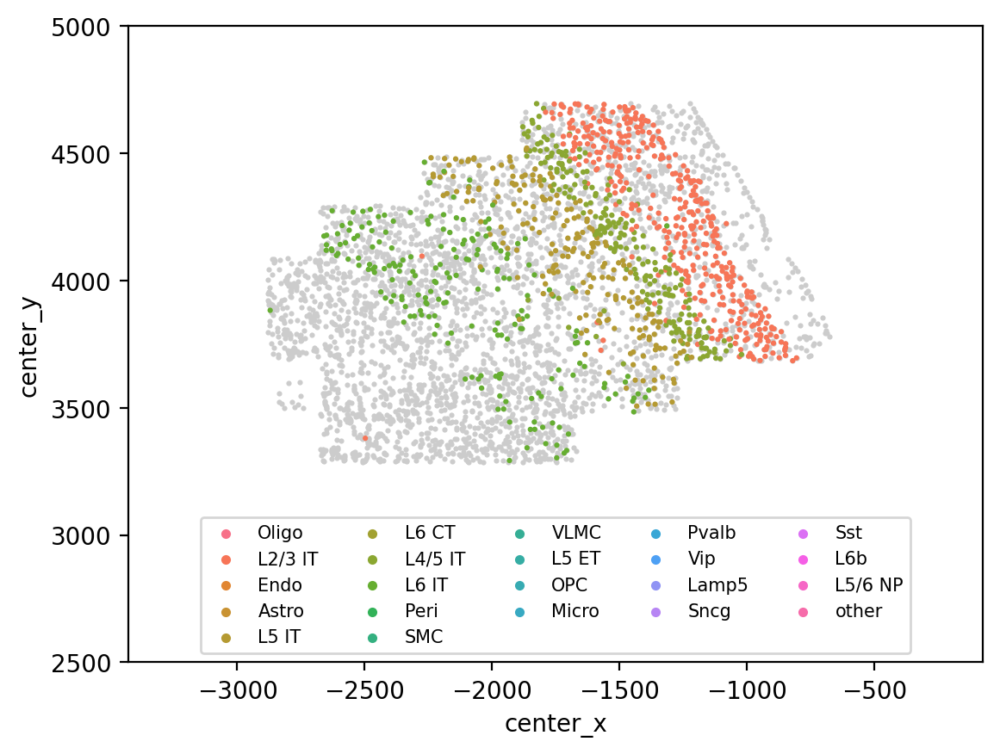

In [305]:
ITTypes = ['L2/3 IT', 'L4/5 IT', 'L5 IT', 'L6 IT']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ITTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([-3000,-500])
plt.ylim([2500, 5000])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=5, loc=8, fontsize=7.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_IT_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

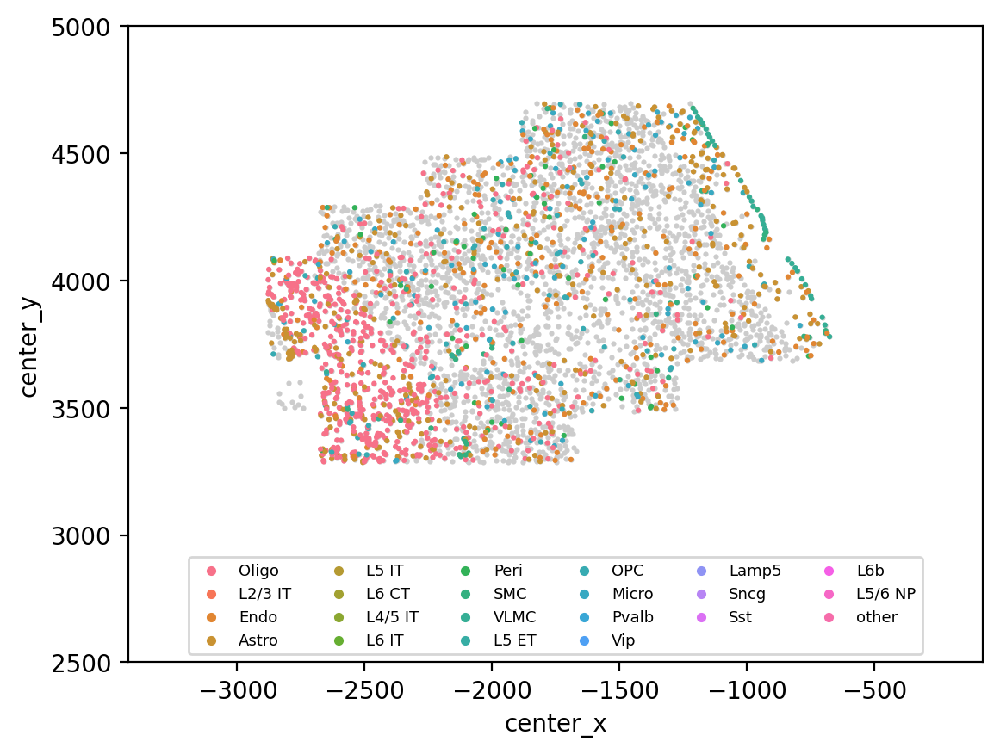

In [306]:
nonNeuTypes = ['Astro', 'Endo', 'Micro', 'OPC', 'Oligo', 'Peri', 'SMC', 'VLMC',]

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in nonNeuTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([-3000,-500])
plt.ylim([2500, 5000])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_nonNeu_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

# 10. Save manually labeled data

In [307]:
save_filename = os.path.join(os.path.join(save_folder, 'manual_labeled_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save merged_adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save merged_adata into file: I:\MERFISH_Analysis\Merged_MOP\manual_labeled_data.h5ad


# dark mode

In [308]:
dark_figure_folder = os.path.join(figure_folder, 'dark')
print(dark_figure_folder)
if not os.path.exists(dark_figure_folder):
    os.makedirs(dark_figure_folder)

I:\MERFISH_Analysis\Merged_MOP\Figures_0626\dark


In [309]:
plt.style.use('dark_background')


20220415


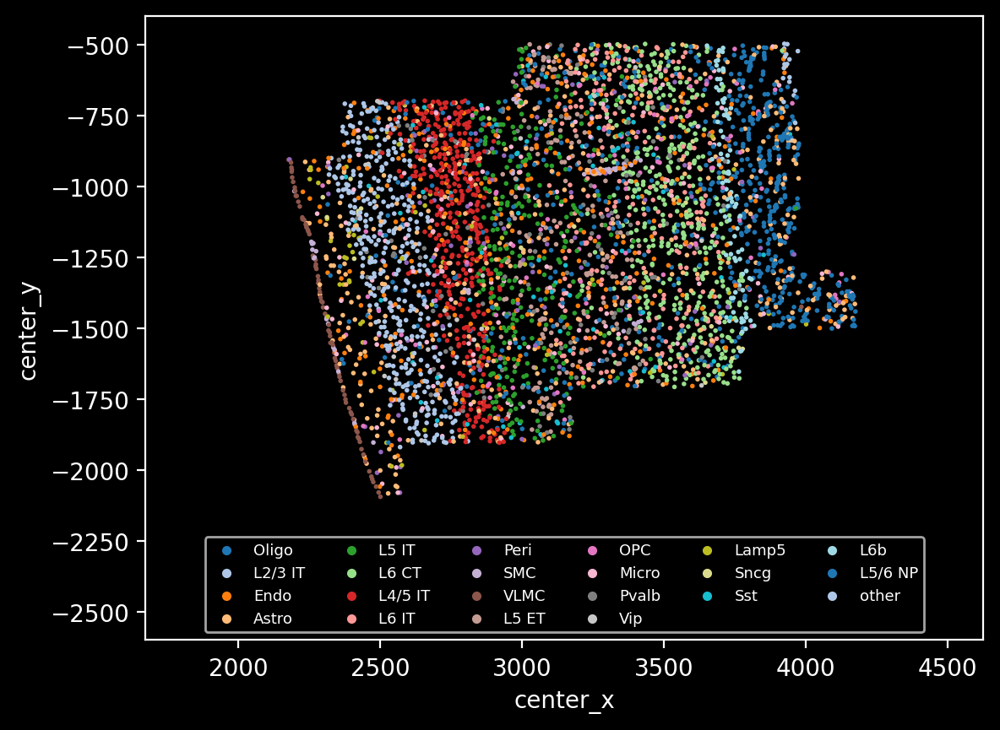

In [310]:
# scatter plot for distributions
experiments = np.unique(merged_adata.obs['experiment'])
sel_exp_id = 2
print(experiments[sel_exp_id])
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_exp_id]]

# visualzie the spatial dist for clusters
#plt.style.use('dark_background')
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                     palette='tab20',
                     hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_all_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

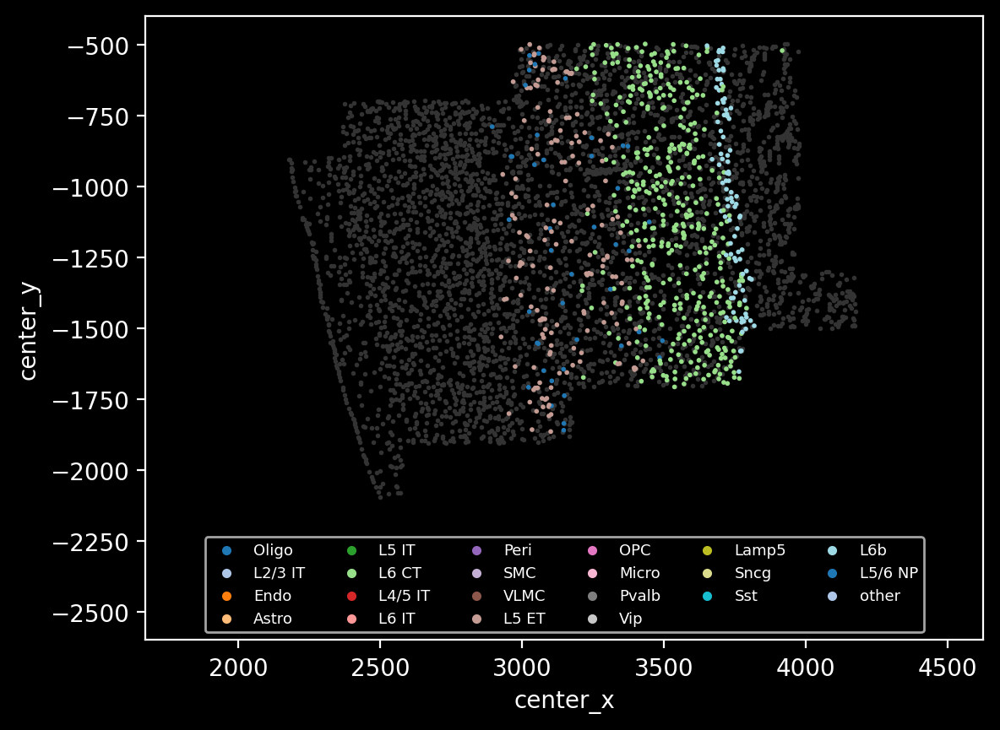

In [311]:
ExciteTypes = ['L5 ET', 'L5/6 NP', 'L6 CT', 'L6b']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ExciteTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_excite_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

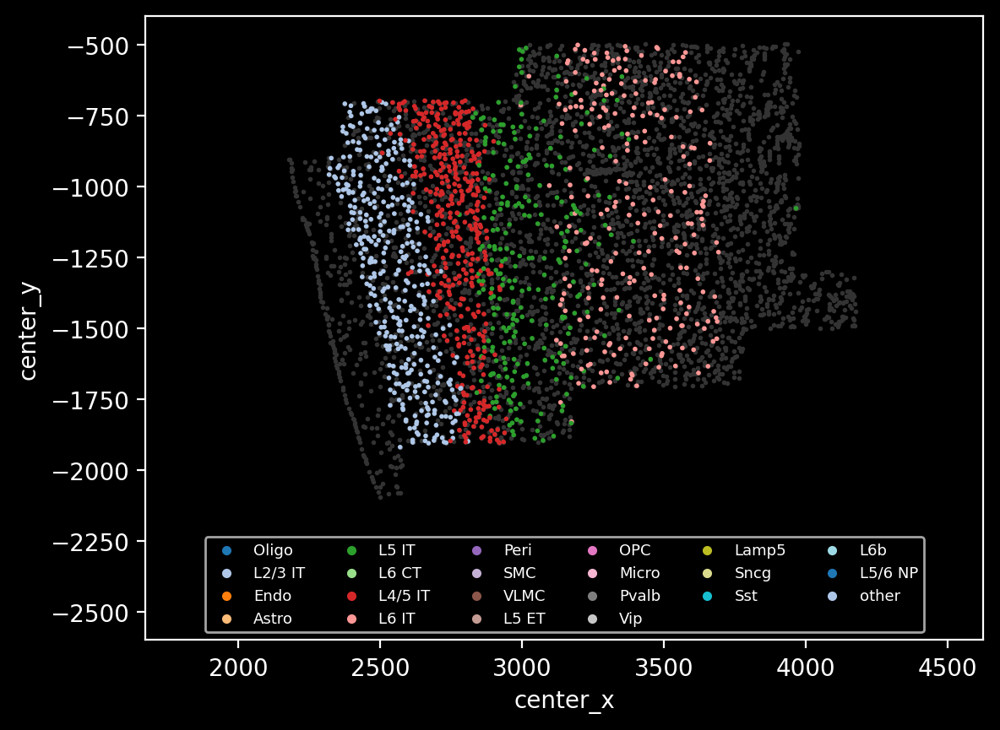

In [312]:
ITTypes = ['L2/3 IT', 'L4/5 IT', 'L5 IT', 'L6 IT']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ITTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_IT_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

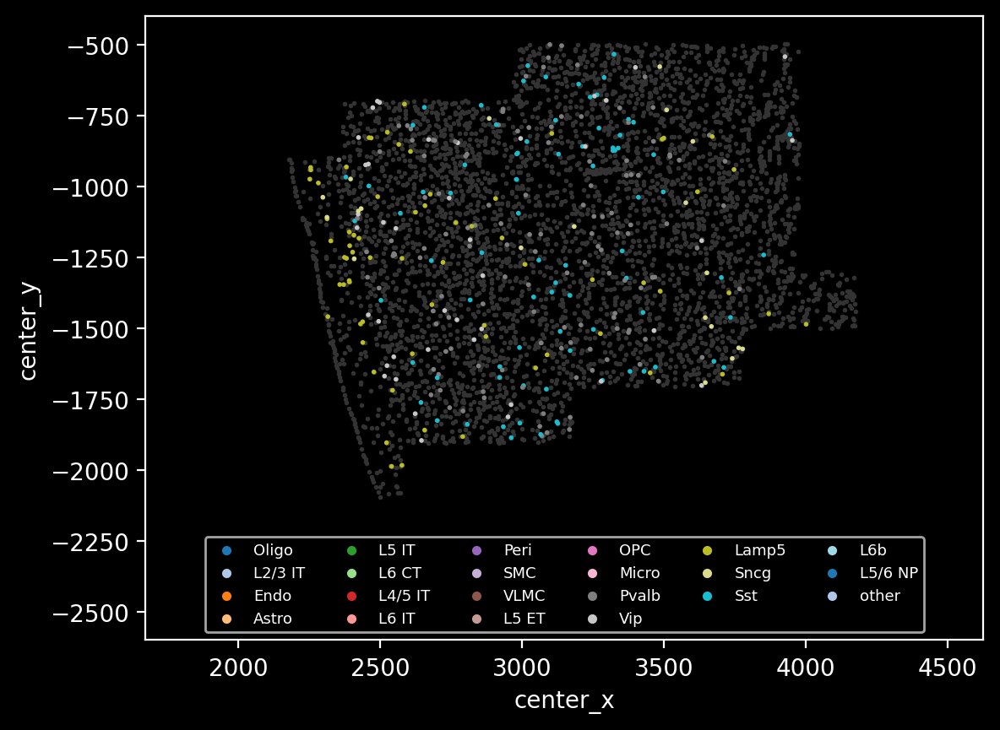

In [313]:
InhbitTypes = ['Lamp5', 'Pvalb', 'Sncg', 'Sst', 'Vip']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in InhbitTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_inhibit_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

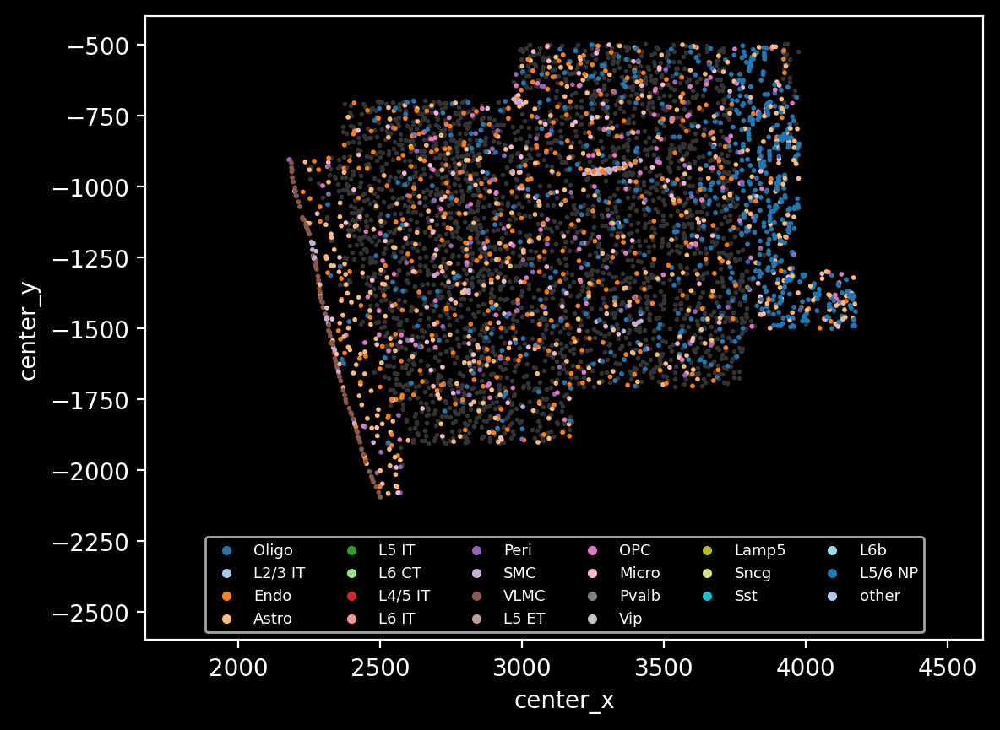

In [314]:
nonNeuTypes = ['Astro', 'Endo', 'Micro', 'OPC', 'Oligo', 'Peri', 'SMC', 'VLMC',]

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in nonNeuTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_nonNeu_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

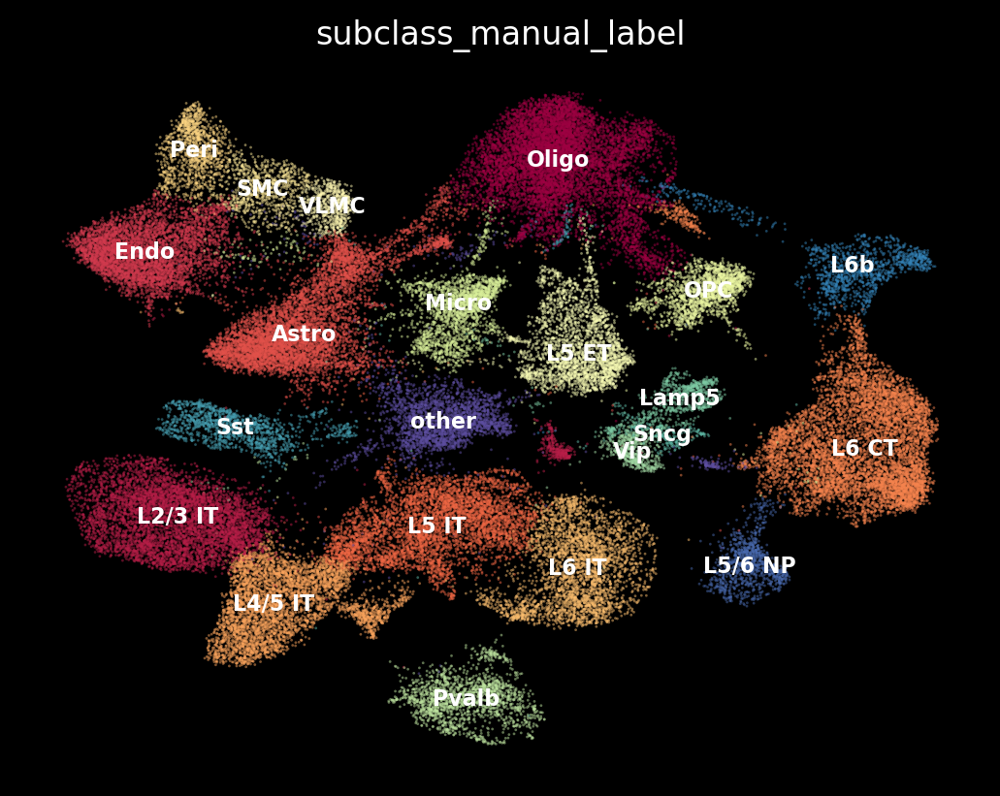

In [315]:
ax = sc.pl.umap(merged_adata, color='subclass_manual_label', 
           legend_loc='on data', legend_fontsize=8,
           size=4, alpha=0.5,
           palette='Spectral', add_outline=False, outline_color=('black','black'), outline_width=(1,0.5),
                save='_dark.png', 
           )
